## <center> Análise da base de Alimentos Regularizados e Situação do Registro </center>

#### <center> 📈 Análise Exploratória de Dados 📉 </center>

#### Importações

In [2]:
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import seaborn as sns 
from collections import Counter
import plotly.express as px

#### Leitura do DF

In [3]:
df = pd.read_excel("./ESFA_CONSUMPTION_DASHBOARD_FORMAT.xlsx")
display(df.head(5))

print('Colunas:\n', df.columns)

,SurveyscountryDESC,SurveyscountryID,SurveystartyearID,SurveyDESC,SurveyID,PopulationGroupL2DESC,PopulationGroupL2ID,ExposurehierarchyL1DESC,ExposurehierarchyL1ID,ExposurehierarchyL2DESC,...,p95_acute_bw_rs,p975_acute,p975_acute_rs,p975_acute_bw,p975_acute_bw_rs,p99_acute,p99_acute_rs,p99_acute_bw,p99_acute_bw_rs,level
0,Austria,14,2005.0,Austrian Study on Nutritional Status 2005-06,1,Adults,10,Alcoholic beverages,10489503,Alcoholic beverages,...,0.000000,1685.50,0.0,13.848361,0.000000,1760.2,0.0,14.440984,0.000000,7
1,Austria,14,2005.0,Austrian Study on Nutritional Status 2005-06,1,Adults,10,Alcoholic beverages,10489503,Beer and beer-like beverage,...,7.142857,2000.00,990.0,23.467371,11.936605,2232.0,1500.0,27.720513,18.681044,7
2,Austria,14,2005.0,Austrian Study on Nutritional Status 2005-06,1,Adults,10,Alcoholic beverages,10489503,Beer and beer-like beverage,...,0.000000,962.50,0.0,15.111020,0.000000,985.0,0.0,15.419408,0.000000,7
3,Austria,14,2005.0,Austrian Study on Nutritional Status 2005-06,1,Adults,10,Alcoholic beverages,10489503,Beer and beer-like beverage,...,0.000000,1468.75,0.0,15.333581,0.000000,1487.5,0.0,15.508432,0.000000,7
4,Austria,14,2005.0,Austrian Study on Nutritional Status 2005-06,1,Adults,10,Alcoholic beverages,10489503,Beer and beer-like beverage,...,0.000000,2150.00,0.0,28.805970,0.000000,2360.0,0.0,31.522388,0.000000,7


Colunas:
 Index(['SurveyscountryDESC', 'SurveyscountryID', 'SurveystartyearID',
       'SurveyDESC', 'SurveyID', 'PopulationGroupL2DESC',
       'PopulationGroupL2ID', 'ExposurehierarchyL1DESC',
       'ExposurehierarchyL1ID', 'ExposurehierarchyL2DESC',
       'ExposurehierarchyL2ID', 'ExposurehierarchyL3DESC',
       'ExposurehierarchyL3ID', 'ExposurehierarchyL4DESC',
       'ExposurehierarchyL4ID', 'ExposurehierarchyL5DESC',
       'ExposurehierarchyL5ID', 'ExposurehierarchyL6DESC',
       'ExposurehierarchyL6ID', 'ExposurehierarchyL7DESC',
       'ExposurehierarchyL7ID', 'Metrics', 'comment_Acute',
       'Comment_Acute_all', 'comment_chronic', 'comment_chronic_all',
       'con_days', 'count_days_s_pg', 'count_days_wg', 'count_subject_s_pg',
       'count_subject_wg', 'per_customer', 'avg_chronic', 'avg_chronic_rs',
       'avg_chronic_bw', 'avg_chronic_bw_rs', 'STD_CH', 'STD_CH_RS',
       'STD_CH_BW', 'STD_CH_BW_RS', 'p5_chronic', 'p5_chronic_rs',
       'p5_chronic_bw', 'p5_chro

#### Separando e renomeando as colunas necessárias para a análise

In [4]:
df = df[['SurveyscountryDESC', 'PopulationGroupL2DESC', 'ExposurehierarchyL1DESC', 'ExposurehierarchyL2DESC', 'count_days_s_pg', 'level']]

df = df.rename(columns={
    'SurveyscountryDESC': 'Country',
    'PopulationGroupL2DESC': 'PopulationGroup',
    'ExposurehierarchyL1DESC': 'ConsumptionCategory',
    'ExposurehierarchyL2DESC': 'ConsumptionSpecificity',
    'count_days_s_pg': 'GramsPerDays',
    'level': 'Days'
})

#Nova coluna que calcula as gramas em um único dia, para todos os dados ficarem igualados
df['GramsOneDay'] = (df['GramsPerDays'] / df['Days']).round(1)

display(df)

,Country,PopulationGroup,ConsumptionCategory,ConsumptionSpecificity,GramsPerDays,Days,GramsOneDay
0,Austria,Adults,Alcoholic beverages,Alcoholic beverages,2123,7,303.3
1,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
2,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
3,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
4,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
...,...,...,...,...,...,...,...
307079,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307080,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307081,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307082,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5


In [5]:
valor_maximo = df['GramsOneDay'].max()
print(f"Valor Máximo: {valor_maximo}")

# Obter o valor mínimo
valor_minimo = df['GramsOneDay'].min()
print(f"Valor Mínimo: {valor_minimo}")

Valor Máximo: 20838.0
Valor Mínimo: 0.3


In [6]:
valores_unicos = df['ConsumptionSpecificity'].unique()
print(valores_unicos)

['Alcoholic beverages' 'Beer and beer-like beverage'
 'Mixed alcoholic drinks' 'Unsweetened spirits and liqueurs'
 'Wine and wine-like drinks' 'Animal and vegetable fats/oils'
 'Fat emulsions and blended fats'
 'Hot drinks and similar (coffee, cocoa, tea and herbal infusions)'
 'Ingredients for coffee, cocoa, tea, and herbal infusions'
 'Dishes, incl. Ready to eat meals (excluding soups and salads)'
 'Fried or extruded cereal, seed or root-based products'
 'Soups and salads' 'Processed eggs' 'Unprocessed eggs' 'Crustaceans'
 'Fish (meat)' 'Fish and seafood processed' 'Molluscs'
 'Fruit used as fruit' 'Processed fruit products'
 'Concentrated or dehydrated fruit/vegetables juices'
 'Extracts of plant origin' 'Fruit / vegetable juices and nectars'
 'Bread and similar products' 'Breakfast cereals'
 'Cereals and cereal primary derivatives' 'Fine bakery wares'
 'Pasta, doughs and similar products' 'Legumes'
 'Nuts, oilseeds and oilfruits'
 'Processed legumes, nuts, oilseeds and spices' 'Spi

#### Excluindo linhas vazias

In [ ]:
df = df.dropna()
display(df)


,Country,PopulationGroup,ConsumptionCategory,ConsumptionSpecificity,GramsPerDays,Days,GramsOneDay
0,Austria,Adults,Alcoholic beverages,Alcoholic beverages,2123,7,303.3
1,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
2,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
3,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
4,Austria,Adults,Alcoholic beverages,Beer and beer-like beverage,2123,7,303.3
...,...,...,...,...,...,...,...
307079,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307080,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307081,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5
307082,United Kingdom,Toddlers,Water and water-based beverages,Water based beverages,5217,6,869.5


#### Salvando base em um arquivo pickle

In [8]:
with open('base_consumo', mode = 'wb') as f:
    pickle.dump(df, f)

### Normalização e Padronização

#### Verificando a existência de Outliers

In [9]:
lista_categorias = list(Counter(df['ConsumptionSpecificity']).keys())
lista_categorias_sem_alteracao = list(Counter(df['ConsumptionSpecificity']).keys())
lista_valores = list(Counter(df['ConsumptionSpecificity']).values())

fig = px.bar(df, lista_categorias, lista_valores, title='Consumo por categoria')
fig.show()


#### Agrupamento de outliers em uma nova categoria: "Others"

In [10]:
lista_categorias_agrupada = lista_categorias
for i in range (0, len(lista_categorias)):
  # Se o tipo possui menos de 100 registros, ele vira o tipo "Others"
  if (int(lista_valores[i]) < 100):
    lista_categorias_agrupada[i] = 'Others'   

fig = px.histogram(df, lista_categorias_agrupada, lista_valores, title='Consumo por categoria', height=1000, width=1000)
fig.show()

### Avaliação dos dados preparados

Valores estatísticos:
        GramsPerDays           Days    GramsOneDay
count  303808.000000  303808.000000  303808.000000
mean     2606.385075       5.263726     540.328239
std      3421.855838       1.409854     776.487164
min         2.000000       2.000000       0.300000
25%       691.000000       4.000000     133.000000
50%      1363.000000       5.000000     282.900000
75%      2773.000000       6.000000     646.200000
max     20838.000000       7.000000   10419.000000


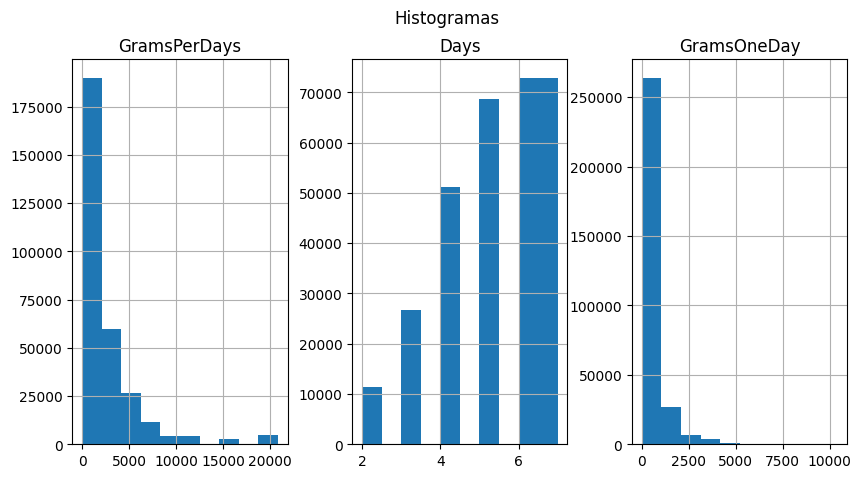

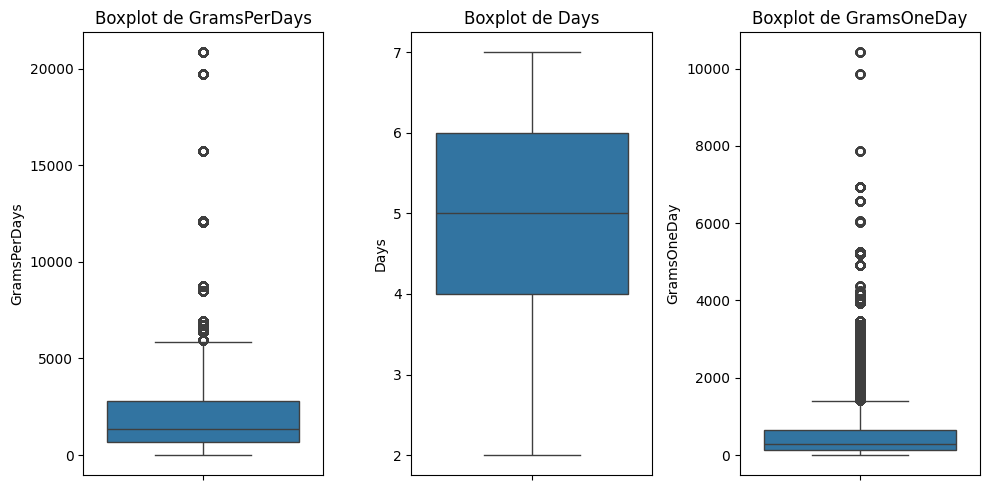

In [11]:
# Avaliando valores estatísticos
stats = df[['GramsPerDays', 'Days', 'GramsOneDay']].describe()

# Exibindo os valores estatísticos
print("Valores estatísticos:")
print(stats)

# Plotando histogramas para as variáveis numéricas
df[['GramsPerDays', 'Days', 'GramsOneDay']].hist(bins=10, figsize=(10, 5), layout=(1, 3))
plt.suptitle('Histogramas')
plt.show()

# Plotando boxplots para as variáveis numéricas
plt.figure(figsize=(10, 5))
for i, column in enumerate(['GramsPerDays', 'Days', 'GramsOneDay'], 1):
    plt.subplot(1, 3, i)
    sns.boxplot(data=df, y=column)
    plt.title(f'Boxplot de {column}')

plt.tight_layout()
plt.show()

In [12]:
# Definindo listas de categorias e valores (substitua com seus dados reais)
lista_categorias = df['ConsumptionCategory'].tolist()
lista_valores = df['GramsPerDays'].tolist()

# Substituindo categorias com valores abaixo de 1000 por 'Others'
df['AggregatedCategory'] = df['ConsumptionCategory']
df.loc[df['GramsPerDays'] < 1000, 'AggregatedCategory'] = 'Others'

# Criando o boxplot
fig = px.box(
    df, 
    x='AggregatedCategory', 
    y='GramsPerDays',
    title='Boxplot do Consumo por Categoria (com Outliers Como "Others")',
    height=1000,
    width=1000
)

fig.show()


Após criarmos a categoria "Others" conseguimos perceber uma diferença na centralidade dos dados, afinal, como generaliza apenas produtos com menos de 1000 registros, a sua centralização e margem fica bem pequena. Os produtos para população jovem não possui outliers, o que pode ser entendido com um consumo muito padronizado em relação ao seu cotidiano. O interessante é que as outras margens e até mesmo outliers se mantém parecidss, podendo indicar um consumo homogêneo da população europeia. No entanto, a centralidade do consumo altera. 

#### Análisando consumo médio por país

In [13]:
# Agrupando os dados por país e categoria de consumo e calcular a soma do consumo em gramas por dia
df_grouped = df.groupby(['Country', 'ConsumptionCategory'], as_index=False)['GramsPerDays'].sum()

# Criando o gráfico usando Plotly Express
fig = px.bar(
    df_grouped, 
    x='Country', 
    y='GramsPerDays', 
    color='ConsumptionCategory',
    title='Consumo Médio por Categoria em Diferentes Países',
    labels={'GramsPerDays': 'Gramas por Dia', 'Country': 'País'},
    barmode='group'
)

# Ajustando o layout para melhorar a visualização
fig.update_layout(xaxis_title='País', yaxis_title='Gramas por Dia', xaxis_tickangle=-45)

fig.show()


É possível perceber aspectos culturais em atos como, por exemplo, consumir grãos com mais frequencia. Geografia também impacta no consumo alimentar. As bases alimentares também se mantém, apesar de alguns países consumirem menos carne, vegatis e grãos se mantém altos em todos os países.

#### Relação entre dias de consumo e a quantia consumida

In [14]:
# Criando o gráfico usando Plotly Express
fig = px.scatter(
    df, 
    x='Days', 
    y='GramsOneDay', 
    color='Country',
    title='Correlação entre Dias de Consumo e Quantidade Consumida',
    labels={'Days': 'Dias de Consumo', 'GramsOneDay': 'Gramas Consumidos em Um Dia'}
)

# Ajustando o layout para melhorar a visualização
fig.update_layout(xaxis_title='Dias de Consumo', yaxis_title='Gramas Consumidos em Um Dia')

fig.show()


Apesar do consumo se manter baixo e irrelevante em alguns países, tendo um consumo parecido na maioria dos países, outros demonstram como a população do país tende a fazer as compras na segunda para armezanar alimentos durante a semana. Outra hipótese é que no começo da semana a pessoa pode possuir mais dinheiro (isso se referindo ao começo do mês).

#### Consumo por grupo populaciona entre os países

In [15]:
# Agrupando os dados por país e grupo populacional, calculando a soma do consumo em gramas por dia
df_grouped = df.groupby(['Country', 'PopulationGroup'], as_index=False)['GramsOneDay'].sum()

# Criando o gráfico usando Plotly Express
fig = px.bar(
    df_grouped, 
    x='Country', 
    y='GramsOneDay', 
    color='PopulationGroup',
    title='Distribuição de Consumo por Grupos Populacionais em Diferentes Países',
    labels={'GramsOneDay': 'Gramas Consumidos em Um Dia', 'Country': 'País'},
    barmode='group'
)

# Ajustando o layout para melhorar a visualização
fig.update_layout(xaxis_title='País', yaxis_title='Gramas Consumidos em Um Dia', xaxis_tickangle=-45)

fig.show()

Visando o gráfico, é possível observar que nossa base é predominantemente formada por adultos, já que, possívelmente, são aqueles que possuem mais dinheiro e condições fisícas de ir até o mercado ou selecionar as compras. É interessante observar também que mulheres grávidas estão menos presentes, afinal, não devem se responsabilizar de tarefas comulmentes cotidianas para adultos.